# Sistema de recomendação

Análise exploratória para o dataset de pedidos de compras

## Importação das bibliotecas para analise dos dados

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt

pd.reset_option('^display')
pd.options.display.max_colwidth = None
pd.options.display.max_columns = None

plt.style.use('ggplot')


### Dataset com descrição dos dados

In [2]:
df = pd.read_excel('Data Column Understanding.xlsx')
df

,Column Name,Meaning
0,Doc. Date,Invoice Document Date
1,Material,Material ID
2,Order qty,The number of Material/SKU ordered in one order (for one Wholesaler)
3,Ship-to nu,Wholesaler ID
4,PCS delivered,Pieces delivered of the Material/SKU in one order (different from order quantity as in 1 order quantity can have multiple pieces)
5,HL delivered,Hectolitre delivered of the Material/SKU in one order
6,delivery_days,Delivery days for the Material
7,delivery_flag,"Whether delivered or not ( 0 - not delivered, 1 - delivered)"
8,lead_time_creation_vs_rdd_flag,"Lead time of creation of the document vs delivery days (LOGIC: off/on=""on-trade“ – (Order Creation Date+4(excluding holidays and order creation date)) <= RDD then ""OK"", else ""NOK""\noff/on=“off-trade“– (Order Creation Date+7(excluding holidays and order creation date)) <= RDD then ""OK"", else ""NOK"")"
9,MACO/HL,Contribution per hectoliter of the beer


### De-para dos nomes das colunas

In [3]:
columns_map = {
    'Doc. Date': 'PedidoDataDocumento',
    'Material': 'PedidoProdutoId',
    'Order qty': 'PedidoOrdem',
    'Ship-to nu': 'PedidoAtacadistaId',
    'PCS delivered': 'PedidoQuantidade',
    'HL delivered': 'PedidoHectolitroEntregue',
    'delivery_days': 'PedidoDiasEntrega',
    'delivery_flag': 'PedidoEntregue',
    'lead_time_creation_vs_rdd_flag': 'PedidoLeadTimeEntrega',
    'MACO/HL ': 'PedidoContribuicaoHectolitro',
    'Groupement': 'AtacadistaGrupoImpostoPreco',
    'Postal Code': 'AtacadistaCodigoPostal',
    'Street': 'AtacadistaRuaEndereco',
    'Sous groupement': 'AtacadistaSubgrupo',
    'M2_Territory_ID': 'AtacadistaLocalizacaoId',
    'M1_Territory_ID': 'AtacadistaSubLocalizacaoId',
    'Dépt': 'AtacadistaDepartamento',
    'Brand': 'ProdutoMarca',
    'Subrand': 'ProdutoSubmarca',
    'SEGMENTS : Pils / Spécialités / Superspécialités/Bouteille Young adult': 'ProdutoSegmento2',
    'Container Type': 'ProdutoTipoContainer',
    'Container Size': 'ProdutoTamanhoContainer',
    'Variétés': 'ProdutoVariedade',
    'Segment LE': 'ProdutoSegmento1',
    'Latitude': 'AtacadistaLatitude',
    'Longitude': 'AtacadistaLongitude',
    'Degre Alc': 'ProdutoPercentAlcoolico',
    'TTC': 'PedidoPrecoFinalParaUmProd',
    'Brut + TE': 'PedidoTaxas',
    'DA': 'PedidoTaxaTransporteAereo',
    'Net + TE - Hors majoration de rompu de palette': 'PedidoPrecoLiquidoDescontoPaliteQuebrado'
}

### Leitura do dataset dos dados e rename das colunas

In [4]:
df = pd.read_excel('Data.xlsx')
df.drop(columns=['Unnamed: 0'], inplace=True)
df.columns = df.columns.map(columns_map)

## Analise do dataset

Identificando campos e variaveis

In [5]:
df.head()

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,AtacadistaLatitude,AtacadistaLongitude,ProdutoPercentAlcoolico,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
0,2021-01-11,10946,5.0,29606863,350.0,21.0,7,1,1,150.689825,FRANCE BOISSONS,59160,RUE DU CHEMIN SAINT MARTIN,France BOISSONS,FR01_ON_1000,FR01_ON_1004,59.0,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,50.6455,2.9619,6.6,18.137448,15.582,15.114540,0.0
1,2021-01-11,19898,2.0,29606863,140.0,8.4,7,1,1,141.207904,FRANCE BOISSONS,59160,RUE DU CHEMIN SAINT MARTIN,France BOISSONS,FR01_ON_1000,FR01_ON_1004,59.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.6455,2.9619,5.0,17.396467,14.688,14.497056,0.0
2,2021-01-11,80176,4.0,29606863,280.0,16.8,7,1,1,92.872307,FRANCE BOISSONS,59160,RUE DU CHEMIN SAINT MARTIN,France BOISSONS,FR01_ON_1000,FR01_ON_1004,59.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.6455,2.9619,0.0,12.279859,10.368,10.233216,0.0
3,2021-01-11,66989,1.0,29606863,70.0,4.2,7,1,1,195.334035,FRANCE BOISSONS,59160,RUE DU CHEMIN SAINT MARTIN,France BOISSONS,FR01_ON_1000,FR01_ON_1004,59.0,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,50.6455,2.9619,8.0,21.996000,18.330,18.330000,0.0
4,2021-01-08,11766,70.0,29378784,70.0,4.2,6,1,1,142.902378,INDEPENDANTS,62570,PLACE JEAN JAURES,ALLAN,FR01_ON_2000,FR01_ON_2006,62.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.6978,2.2423,5.2,17.359200,14.466,14.466000,0.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73670 entries, 0 to 73669
Data columns (total 31 columns):
 #   Column                                    Non-Null Count  Dtype         
---  ------                                    --------------  -----         
 0   PedidoDataDocumento                       73670 non-null  datetime64[ns]
 1   PedidoProdutoId                           73670 non-null  int64         
 2   PedidoOrdem                               73670 non-null  float64       
 3   PedidoAtacadistaId                        73670 non-null  int64         
 4   PedidoQuantidade                          73666 non-null  float64       
 5   PedidoHectolitroEntregue                  73670 non-null  float64       
 6   PedidoDiasEntrega                         73670 non-null  int64         
 7   PedidoEntregue                            73670 non-null  int64         
 8   PedidoLeadTimeEntrega                     73670 non-null  int64         
 9   PedidoContribuicaoHectolitro

In [7]:
print('Quantidade máxima de registros para colunas: ', df.count().values.max())
print('Quantidade mimina de registros para colunas: ', df.count().values.min())

Quantidade máxima de registros para colunas:  73670
Quantidade mimina de registros para colunas:  28316


In [8]:
print('DataInicial: ', df['PedidoDataDocumento'].min())
print('DataFinal: ', df['PedidoDataDocumento'].max())
print('Período: ', (df['PedidoDataDocumento'].max()-df['PedidoDataDocumento'].min()))

DataInicial:  2019-08-01 00:00:00
DataFinal:  2021-02-22 00:00:00
Período:  571 days 00:00:00


In [9]:
df.sort_values(by=['PedidoDataDocumento'], inplace=True)
df.reset_index(drop=True, inplace=True)
df.head()

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,AtacadistaLatitude,AtacadistaLongitude,ProdutoPercentAlcoolico,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
0,2019-08-01,63482,1.0,29804035,70.0,4.2,6,1,1,122.037438,NATIONAL CUSTOMER,53200,RUE DE ROMAINVILLE,NEODIF,3M,3M,53.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.7993,-0.7210,5.1,14.806188,12.786,12.338490,0.0
1,2019-08-01,6013,4.0,29596966,32.0,6.4,7,1,1,159.181849,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,6.6,62.666534,55.520,52.222112,0.0
2,2019-08-01,10946,3.0,29596966,210.0,12.6,7,1,1,150.689825,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,44.5543,6.1627,6.6,17.894369,15.582,14.911974,0.0
3,2019-08-01,65642,20.0,29596966,20.0,4.0,7,1,1,NaN,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,NaN,NaN,NaN,NaN,NaN
4,2019-08-01,11574,40.0,29596966,320.0,96.0,7,1,1,85.212929,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,4.8,57.623832,49.710,48.019860,0.0


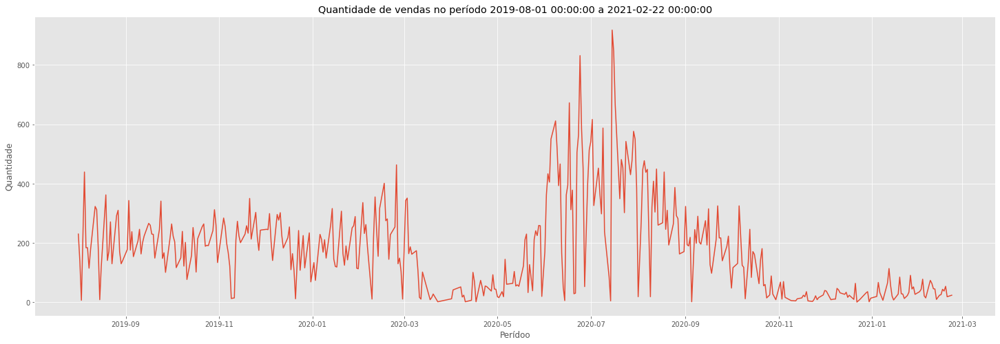

In [10]:
periodo = df.groupby(['PedidoDataDocumento'])['PedidoDataDocumento'].count()
plt.figure(figsize=(25,8))
plt.title('Quantidade de vendas no período {} a {}'.format(df['PedidoDataDocumento'].min(), df['PedidoDataDocumento'].max()))
sns.lineplot(x=periodo.index, y=periodo.values)
plt.xlabel('Perídoo')
plt.ylabel('Quantidade')
plt.show()

### Análise da relação das variáveis

In [11]:
from pandas_profiling import ProfileReport

In [12]:
profile = ProfileReport(df, title='Análise estatistica do dataset', explorative=False)
profile

Render HTML: 100%|██████████| 1/1 [00:07<00:00,  7.78s/it]


In [13]:
del profile

### Separação do dataset em datasets de contextos

Como o objetivo de ter um maior entendimento do dataset foi porposto a separação do dataset inicial em três grupos de informações, no qual poderá facilitar o entendimento dos dados e do contexto de cada informação.

In [14]:
df_produto = df[[column for column in df.columns if 'Produto' in column]]
df_atacadista = df[[column for column in df.columns if 'Atacadista' in column]]
df_pedido = df[[column for column in df.columns if 'Pedido' in column]]

In [15]:
df_produto.head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
0,63482,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.1
1,6013,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6
2,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,6.6
3,65642,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,11574,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8


In [16]:
df_atacadista.head()

,PedidoAtacadistaId,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,AtacadistaLatitude,AtacadistaLongitude
0,29804035,NATIONAL CUSTOMER,53200,RUE DE ROMAINVILLE,NEODIF,3M,3M,53.0,47.7993,-0.7210
1,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627
2,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627
3,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627
4,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627


In [17]:
df_pedido.head()

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
0,2019-08-01,63482,1.0,29804035,70.0,4.2,6,1,1,122.037438,14.806188,12.786,12.338490,0.0
1,2019-08-01,6013,4.0,29596966,32.0,6.4,7,1,1,159.181849,62.666534,55.520,52.222112,0.0
2,2019-08-01,10946,3.0,29596966,210.0,12.6,7,1,1,150.689825,17.894369,15.582,14.911974,0.0
3,2019-08-01,65642,20.0,29596966,20.0,4.0,7,1,1,NaN,NaN,NaN,NaN,NaN
4,2019-08-01,11574,40.0,29596966,320.0,96.0,7,1,1,85.212929,57.623832,49.710,48.019860,0.0


## Análise do dataset de produto

Analisar e enteder os produtos que existem cadastrados

In [18]:
print('Quantidade de produtos: ', len(df_produto['PedidoProdutoId']))
print('Quantidade de produtos unicos: ', len(df_produto['PedidoProdutoId'].unique()))

Quantidade de produtos:  73670
Quantidade de produtos unicos:  179


Validação de produtos sem caracteristicas

In [19]:
column, _ = list(filter(lambda x: x[1] == True, df_produto.isnull().any().items())).pop(0)
df_produto[df_produto[column].isnull()].head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
0,63482,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.1
1,6013,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6
3,65642,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,11574,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8
5,3372,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.2


Validação de produto duplicado

In [20]:
column = df_produto['PedidoProdutoId'].unique()
df_produto[df_produto['PedidoProdutoId'] == column.take(11)]

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
12,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
27,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
96,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
235,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
570,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
...,...,...,...,...,...,...,...,...,...
72716,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
72736,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,NaN
72834,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
72851,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4


### Remoção dos dados sem caracteristicas

In [21]:
df_produto = df_produto.dropna()
df_produto

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
2,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,6.6
6,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,"6,000 L",Ruby,PREMIUM,5.0
11,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,"0,330 L",Ruby,PREMIUM,5.0
12,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
14,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,"6,000 L",Ruby,PREMIUM,5.0
...,...,...,...,...,...,...,...,...,...
73662,61629,KWAK,KWAK,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,8.4
73663,64665,LEFFE,LEFFE AMBREE,Spécialités,PERFECT DRAFT,"6,000 L",Ambrée,PREMIUM,6.6
73665,48537,LEFFE,LEFFE ROYALE,Super Spécialités,PERFECT DRAFT,"6,000 L",Whitbread Golding,PREMIUM,7.5
73667,17028,LEFFE,LEFFE RITUEL 9°,Super Spécialités,PERFECT DRAFT,"6,000 L",Rituel,PREMIUM,9.0


### Remoção dos dados em duplicidade, com base no Id do produto

In [22]:
df_produto = df_produto.drop_duplicates(subset=['PedidoProdutoId'])
df_produto

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
2,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,6.6
6,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,"6,000 L",Ruby,PREMIUM,5.0
11,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,"0,330 L",Ruby,PREMIUM,5.0
12,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
16,61629,KWAK,KWAK,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,8.4
...,...,...,...,...,...,...,...,...,...
48110,70605,BIRRA DEL BORGO,BIRRA DEL BORGO,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,5.0
49839,20527,LEFFE,LEFFE BLONDE,Spécialités,BOTTLE VP - Hors Tendances,"0,33 L",Blonde,PREMIUM,6.6
63569,82315,KWAK,KWAK,Craft,BOTTLE VP - Hors Tendances,"0,750 L",-,SUPER PREMIUM,8.4
66652,66719,BIRRA DEL BORGO,BIRRA DEL BORGO,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,5.0


In [23]:
df_produto.reset_index(drop=True, inplace=True)

### Ajuste na feature de Tamanho do container

A fim de padronizar essa informação em valor numerico, foi feito o processo de conversão do dado string em numérico, removendo os espaços existentes, letras e caracteres.

In [24]:
df_produto['ProdutoTamanhoContainer'].apply(lambda x: x.replace('L', '').replace(',', '.').strip()).unique()
df_produto['ProdutoTamanhoContainer'] = df_produto['ProdutoTamanhoContainer'].apply(lambda x: round(float(x.replace('L', '').replace(',', '.').strip()),2))

<ipython-input-24-821d3d36c47d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_produto['ProdutoTamanhoContainer'] = df_produto['ProdutoTamanhoContainer'].apply(lambda x: round(float(x.replace('L', '').replace(',', '.').strip()),2))


### Remoção de espaços vazios nas colunas string

In [25]:
columns = [column for column in df_produto.columns if df_produto[column].dtype == object]
df_produto[columns] = df_produto[columns].applymap(str.strip)

C:\Users\angel\anaconda3\lib\site-packages\pandas\core\frame.py:3191: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


### Visualização dos dados referente ao contexto de produto

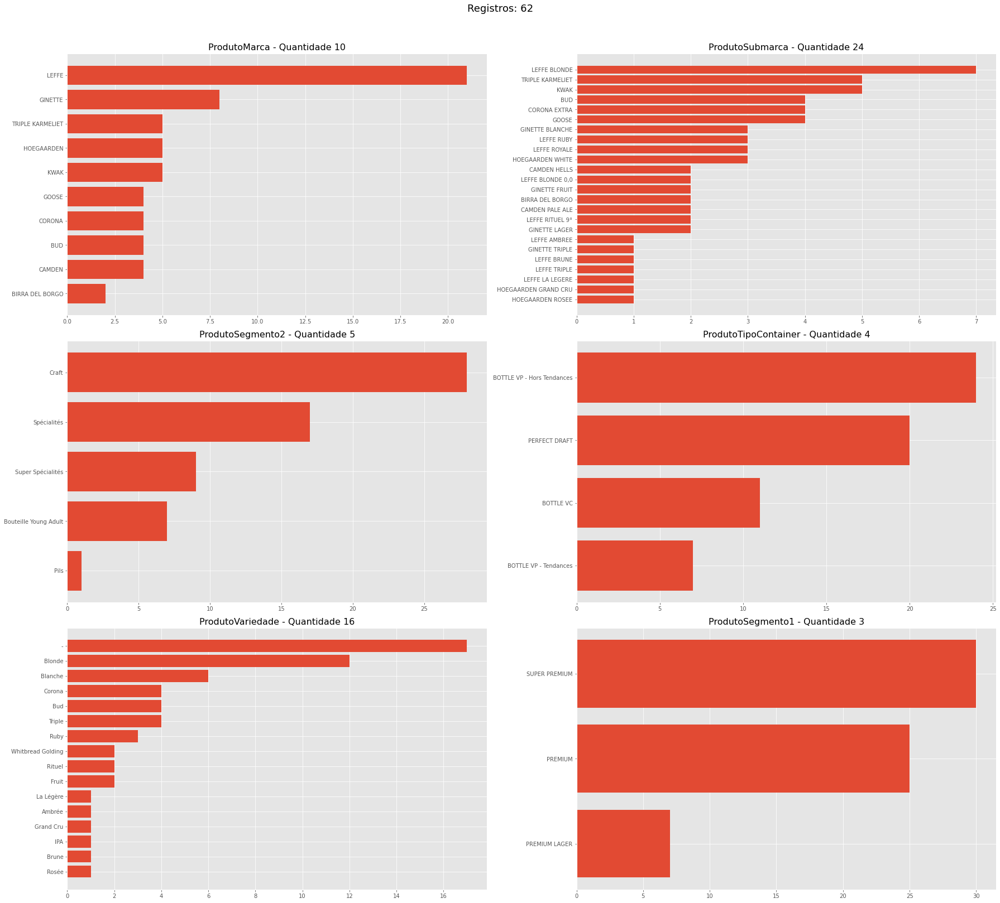

In [26]:
n_rows = np.math.ceil(len(columns) / 2)

fig, ax = plt.subplots(nrows=n_rows, ncols=2, figsize=(25,22))
for i, column in enumerate(columns):
    counts = df_produto[column].value_counts().sort_values()
    ax.flat[i].barh(counts.index, counts.values)
    ax.flat[i].set_title(f'{column} - Quantidade {len(counts)}', size=16)

plt.suptitle(f'Registros: {len(df_produto)}', y=1.02, size=18)
plt.tight_layout()
plt.show()


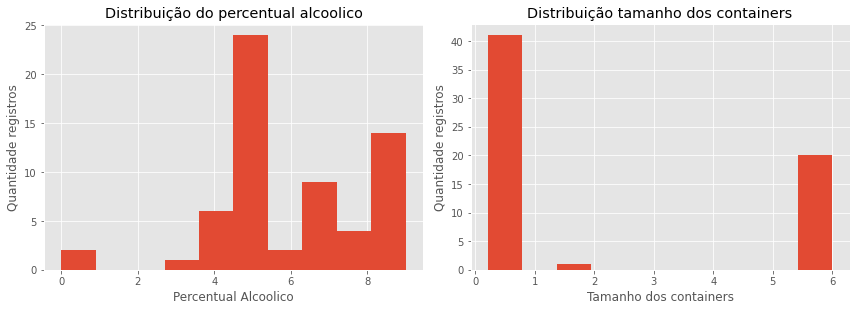

In [27]:
plt.figure(figsize=(12,8))
plt.subplot(221)
plt.title('Distribuição do percentual alcoolico')
plt.hist(df_produto['ProdutoPercentAlcoolico'])
plt.xlabel('Percentual Alcoolico')
plt.ylabel('Quantidade registros')

plt.subplot(222)
plt.title('Distribuição tamanho dos containers')
plt.hist(df_produto['ProdutoTamanhoContainer'])
plt.xlabel('Tamanho dos containers')
plt.ylabel('Quantidade registros')

plt.tight_layout()
plt.show()


### Padronização das features

Padronização das features para melhor analise de correlação e processamento

Conversão dos valores categoricos em numéricos

In [28]:
from sklearn.preprocessing import LabelEncoder

encoders_produto = {}
df_produto_encoder = pd.DataFrame(df_produto[['PedidoProdutoId', 'ProdutoTamanhoContainer', 'ProdutoPercentAlcoolico']])

for column in columns:
    encoders_produto[column] = LabelEncoder()
    df_produto_encoder[column] = encoders_produto[column].fit_transform(df_produto[column].values.ravel())

df_produto_encoder.head()


,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
0,10946,6.00,6.6,8,15,3,3,3,0
1,20614,6.00,5.0,8,21,4,3,13,0
2,30822,0.33,5.0,8,21,4,0,13,0
3,59874,0.33,8.4,9,23,1,0,0,2
4,61629,6.00,8.4,7,13,1,3,0,2


Padronização dos valores numéricos a fim para mante-los em uma mesma escala

In [29]:
from sklearn.preprocessing import StandardScaler

scalers_produto = {}
df_produto_scaler = pd.DataFrame(df_produto_encoder['PedidoProdutoId'])

for column in df_produto_encoder.drop(columns=['PedidoProdutoId']).columns:
    scalers_produto[column] = StandardScaler()
    df_produto_scaler[column] = scalers_produto[column].fit_transform(df_produto_encoder[column].values.reshape(-1,1))

df_produto_scaler.head()

,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
0,10946,1.445750,0.366245,0.862907,0.475924,0.842404,1.272825,-0.371454,-1.151584
1,20614,1.445750,-0.442920,0.862907,1.323023,1.599346,1.272825,1.703332,-1.151584
2,30822,-0.711003,-0.442920,0.862907,1.323023,1.599346,-1.417464,1.703332,-1.151584
3,59874,-0.711003,1.276556,1.239669,1.605390,-0.671481,-1.417464,-0.993889,0.979705
4,61629,1.445750,1.276556,0.486145,0.193558,-0.671481,1.272825,-0.993889,0.979705


Visualização da correlação entre os campos

<AxesSubplot:>

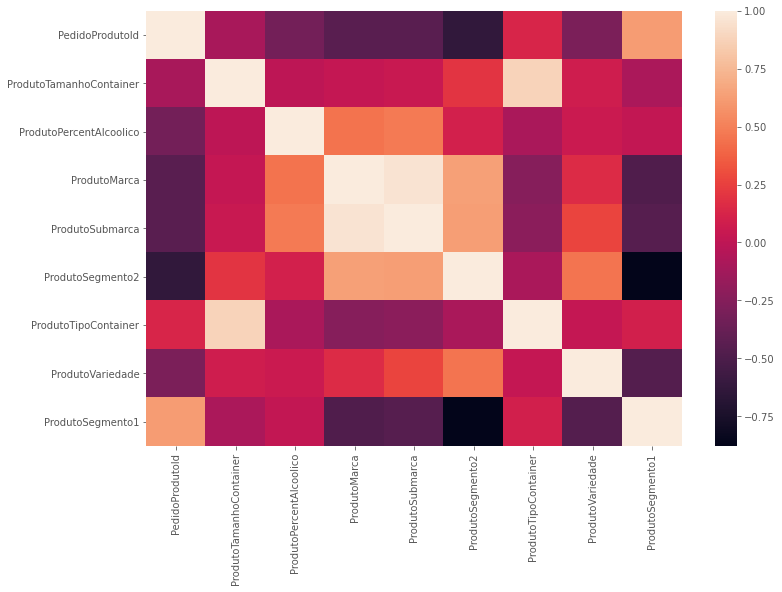

In [30]:
corr = df_produto_scaler.corr()

plt.figure(figsize=(12,8))
sns.heatmap(corr)

Exibição das features com maior correlação

In [31]:
corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)]

,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
PedidoProdutoId,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoTamanhoContainer,NaN,NaN,NaN,NaN,NaN,NaN,0.877584,NaN,NaN
ProdutoPercentAlcoolico,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoMarca,NaN,NaN,NaN,NaN,0.956884,NaN,NaN,NaN,NaN
ProdutoSubmarca,NaN,NaN,NaN,0.956884,NaN,NaN,NaN,NaN,NaN
ProdutoSegmento2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.877348
ProdutoTipoContainer,NaN,0.877584,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoVariedade,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoSegmento1,NaN,NaN,NaN,NaN,NaN,-0.877348,NaN,NaN,NaN


In [32]:
corr_columns = []
for column in corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)].unstack().dropna().drop_duplicates().index.map(list):
    corr_columns += (column)

print(corr_columns)

['ProdutoTamanhoContainer', 'ProdutoTipoContainer', 'ProdutoMarca', 'ProdutoSubmarca', 'ProdutoSegmento2', 'ProdutoSegmento1']


Seleção das variaveis a serem excluídas: Mantendo apenas uma variável das que possuam alta correlação a fim de garantir a caracteristica do produto e remover as outras no qual não agregariam informação ao modelo e poderiam implicar no overfiting

In [33]:
corr_columns = ['PedidoProdutoId', 'ProdutoMarca', 'ProdutoSegmento2', 'ProdutoTipoContainer']

In [34]:
features = df_produto.drop(columns=corr_columns)
features

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
0,LEFFE BLONDE,6.00,Blonde,PREMIUM,6.6
1,LEFFE RUBY,6.00,Ruby,PREMIUM,5.0
2,LEFFE RUBY,0.33,Ruby,PREMIUM,5.0
3,TRIPLE KARMELIET,0.33,-,SUPER PREMIUM,8.4
4,KWAK,6.00,-,SUPER PREMIUM,8.4
...,...,...,...,...,...
57,BIRRA DEL BORGO,6.00,-,SUPER PREMIUM,5.0
58,LEFFE BLONDE,0.33,Blonde,PREMIUM,6.6
59,KWAK,0.75,-,SUPER PREMIUM,8.4
60,BIRRA DEL BORGO,6.00,-,SUPER PREMIUM,5.0


Redução da dimensionalidade mantendo a correlação entre os dados através da extração de componentes principais

In [35]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [36]:
pca = PCA(n_components=2)
components = pca.fit_transform(df_produto_scaler.drop(columns=corr_columns))
print(pca.explained_variance_ratio_)

print('Total de correlação explicada pelos {} componentes principais: {}'.format(pca.n_components, sum(pca.explained_variance_ratio_)))

[0.38299118 0.23575135]
Total de correlação explicada pelos 2 componentes principais: 0.6187425335328613


### Extração da quantidade ideial de clusters para os dados existentes

In [37]:
def quantidade_cluster(data, max_cluster):
    wcss = []
    for n in range(2, max_cluster):
        kmeans = KMeans(n_clusters=n)
        kmeans.fit(X=data)
        wcss.append(kmeans.inertia_)

    return wcss

def quantidade_cluster_otima(wcss):
    x1, y1 = 2, wcss[0]
    x2, y2 = 20, wcss[len(wcss)-1]

    distances = []
    for i in range(len(wcss)):
        x0 = i+2
        y0 = wcss[i]
        numerator = abs((y2-y1)*x0 - (x2-x1)*y0 + x2*y1 - y2*x1)
        denominator = np.sqrt((y2 - y1)**2 + (x2 - x1)**2)
        distances.append(numerator/denominator)
    
    return distances.index(max(distances)) + 2

In [38]:
wcss = quantidade_cluster(components, 21)
n_cluster = quantidade_cluster_otima(wcss)
print('Numero de clusters sugeridos: {}'.format(n_cluster))

Numero de clusters sugeridos: 5


### Criação do algoritmo de cluster para agrupar os dados do produto com base nas caracteristicas atuais

In [39]:
knn = KMeans(n_clusters=n_cluster)
labels = knn.fit_predict(components)

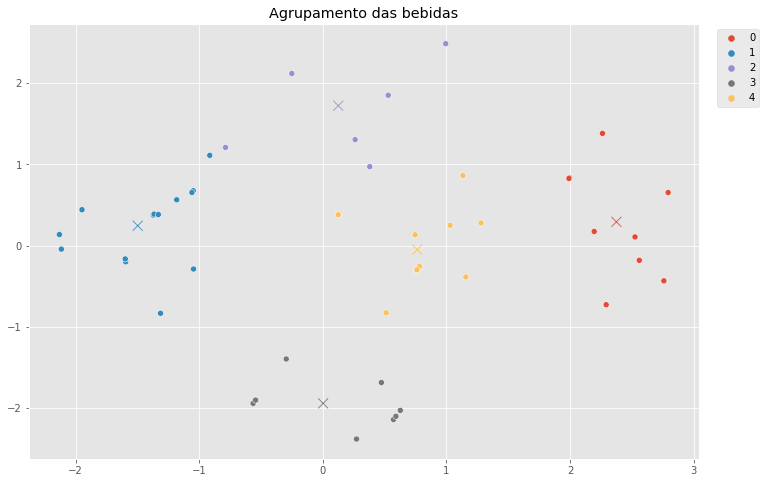

In [84]:
palette = { label: f'C{i}' for i, label in enumerate(range(knn.n_clusters))}

plt.figure(figsize=(12,8))
plt.title('Agrupamento das bebidas')
ax = sns.scatterplot(x=components[:,0], y=components[:,1], hue=knn.labels_, palette=palette)
sns.scatterplot(x=knn.cluster_centers_[:,0], y=knn.cluster_centers_[:,1], hue=range(knn.n_clusters), s=100, palette=palette, legend=False, ax=ax, marker='x')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

### Vinculação das labels de cluster ao dataset

In [41]:
df_produto['cluster'] = labels

<ipython-input-41-01039ba53a84>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_produto['cluster'] = labels


In [42]:
df_produto.head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
0,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,6.00,Blonde,PREMIUM,6.6,4
1,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,6.00,Ruby,PREMIUM,5.0,0
2,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,0.33,Ruby,PREMIUM,5.0,0
3,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,0.33,-,SUPER PREMIUM,8.4,3
4,61629,KWAK,KWAK,Craft,PERFECT DRAFT,6.00,-,SUPER PREMIUM,8.4,3


#### Metrica do agrupamento dos produtos para similaridade

In [43]:
from sklearn.metrics import silhouette_score

print('Silhouette Score: ', silhouette_score(components, labels))

Silhouette Score:  0.5717194314695264


### Buscando produtos similares

#### Com base em um produto existente

In [44]:
produto_id = np.random.choice(df_produto['PedidoProdutoId'], 1)[0]
cluster = df_produto[df_produto['PedidoProdutoId'] == produto_id]['cluster'].values[0]

print(cluster)

df_produto[df_produto['cluster'] == cluster]

4


,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
0,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,6.00,Blonde,PREMIUM,6.6,4
9,10957,HOEGAARDEN,HOEGAARDEN WHITE,Spécialités,BOTTLE VC,0.33,Blanche,PREMIUM,4.9,4
11,3337,LEFFE,LEFFE BLONDE,Spécialités,BOTTLE VC,0.33,Blonde,PREMIUM,6.6,4
13,10611,LEFFE,LEFFE BRUNE,Spécialités,PERFECT DRAFT,6.00,Brune,PREMIUM,6.5,4
18,64665,LEFFE,LEFFE AMBREE,Spécialités,PERFECT DRAFT,6.00,Ambrée,PREMIUM,6.6,4
23,10958,HOEGAARDEN,HOEGAARDEN GRAND CRU,Spécialités,BOTTLE VC,0.33,Grand Cru,PREMIUM,8.5,4
24,59942,GINETTE,GINETTE TRIPLE,Craft,BOTTLE VP - Hors Tendances,0.33,Triple,SUPER PREMIUM,9.0,4
32,6108,LEFFE,LEFFE BLONDE,Spécialités,BOTTLE VP - Hors Tendances,0.75,Blonde,PREMIUM,6.6,4
35,72413,LEFFE,LEFFE BLONDE,Spécialités,BOTTLE VP - Hors Tendances,0.25,Blonde,PREMIUM,6.6,4
41,77034,LEFFE,LEFFE BLONDE,Spécialités,BOTTLE VP - Hors Tendances,0.25,Blonde,PREMIUM,6.6,4


#### Para um produto novo

In [45]:
produto_novo = { 'ProdutoSubmarca': ['LEFFE BLONDE'], 'ProdutoTamanhoContainer': [.55], 'ProdutoSegmento1': ['PREMIUM LAGER'], 'ProdutoVariedade': ['Ruby'], 'ProdutoPercentAlcoolico':[2.85]}
df_produtonovo = pd.DataFrame.from_dict(produto_novo)
df_produtonovo

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoSegmento1,ProdutoVariedade,ProdutoPercentAlcoolico
0,LEFFE BLONDE,0.55,PREMIUM LAGER,Ruby,2.85


In [46]:
for column in df_produtonovo.columns:
    if df_produtonovo[column].dtype == object:
        df_produtonovo[column] = encoders_produto[column].transform(df_produtonovo[column].values.ravel())
    df_produtonovo[column] = scalers_produto[column].transform(df_produtonovo[column].values.reshape(-1,1))

df_produtonovo

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoSegmento1,ProdutoVariedade,ProdutoPercentAlcoolico
0,0.475924,-0.62732,-0.085939,1.703332,-1.530236


In [47]:
component_novo = pca.transform(df_produtonovo)
label = knn.predict(component_novo)
label

array([2])

In [48]:
df_produto[df_produto['cluster'] == label[0]]

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
5,10947,HOEGAARDEN,HOEGAARDEN WHITE,Spécialités,PERFECT DRAFT,6.00,Blanche,PREMIUM,4.8,2
8,71316,BUD,BUD,Pils,PERFECT DRAFT,6.00,Bud,PREMIUM LAGER,5.0,2
10,33335,HOEGAARDEN,HOEGAARDEN ROSEE,Super Spécialités,PERFECT DRAFT,6.00,Rosée,PREMIUM,3.0,2
31,74529,GINETTE,GINETTE LAGER,Craft,BOTTLE VP - Hors Tendances,0.33,Triple,PREMIUM LAGER,4.5,2
38,77721,LEFFE,"LEFFE BLONDE 0,0",Spécialités,BOTTLE VC,0.33,Blonde,PREMIUM,0.0,2
47,74342,GINETTE,GINETTE LAGER,Craft,PERFECT DRAFT,6.00,Triple,PREMIUM LAGER,4.5,2
61,69490,LEFFE,"LEFFE BLONDE 0,0",Spécialités,BOTTLE VC,0.33,Blonde,PREMIUM,0.0,2


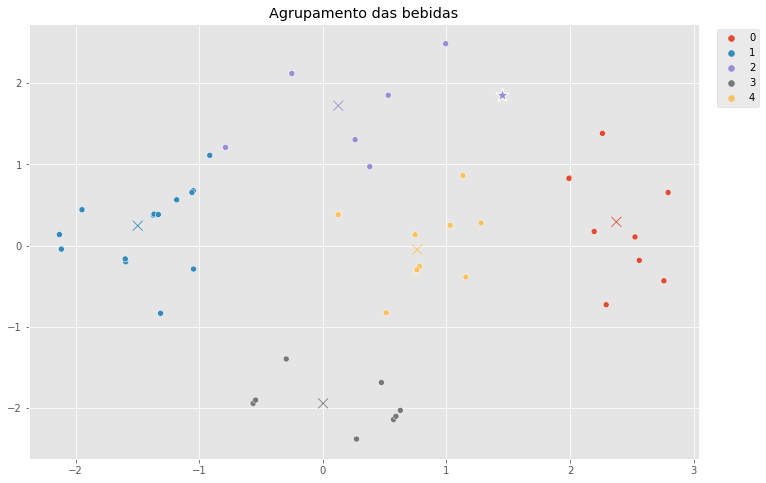

In [85]:
plt.figure(figsize=(12,8))
plt.title('Agrupamento das bebidas')
ax = sns.scatterplot(x=components[:,0], y=components[:,1], hue=knn.labels_, palette=palette)
ax = sns.scatterplot(x=knn.cluster_centers_[:,0], y=knn.cluster_centers_[:,1], hue=range(knn.n_clusters), s=100, palette=palette, legend=False, ax=ax, marker='x')
sns.scatterplot(x=component_novo[:,0], y=component_novo[:,1], hue=label, palette=palette, s=200, ax=ax, marker='*', legend=False)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

## Análise do dataset de atacadista

In [50]:
print('Quantidade de registros', len(df_atacadista))
print('Quantidade de atacadistas unicos', len(df_atacadista['PedidoAtacadistaId'].unique()))

Quantidade de registros 73670
Quantidade de atacadistas unicos 179


Buscando apenas os atacadistras únicos

In [51]:
df_atacadista = df_atacadista.drop_duplicates(subset=['PedidoAtacadistaId'])
df_atacadista

,PedidoAtacadistaId,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,AtacadistaLatitude,AtacadistaLongitude
0,29804035,NATIONAL CUSTOMER,53200,RUE DE ROMAINVILLE,NEODIF,3M,3M,53.0,47.7993,-0.7210
1,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627
8,29378967,DISTRIBOISSONS,17320,RUE JEAN MOULIN,LA ROCHELLE BOISSONS,FR01_ON_1200,FR01_ON_1204,17.0,45.8000,-1.0333
19,29379615,INDEPENDANTS,53000,BOULEVARD LEON BOLLEE,OUEST BOISSONS,FR01_ON_9000,FR01_ON_9002,53.0,48.0667,-0.7667
31,29563830,C10,12000,RUE DES CHARPENTIERS,MESPOULET,FR01_ON_1300,FR01_ON_1304,12.0,44.3601,2.5051
...,...,...,...,...,...,...,...,...,...,...
60890,29801553,FRANCE BOISSONS,45770,305 RUE FRANCIS PERRIN,France BOISSONS,FR01_ON_9000,FR01_ON_9005,45.0,47.9501,1.8760
64078,40007881,C10,54700,479 Rue des Hauts de Feye,REGA,FR01_ON_3000,FR01_ON_3004,54.0,48.8695,6.0403
64678,29379015,C10,88600,8 RUE DE LA VOLOGNE,REGA,FR01_ON_3000,FR01_ON_3004,88.0,48.1679,6.6505
71748,40016990,INDEPENDANTS,80160,36 RUE DES CLABAUDOIS,NaN,NaN,NaN,NaN,49.7394,2.2184


In [52]:
df_atacadista.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 179 entries, 0 to 72206
Data columns (total 10 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   PedidoAtacadistaId           179 non-null    int64  
 1   AtacadistaGrupoImpostoPreco  179 non-null    object 
 2   AtacadistaCodigoPostal       179 non-null    int64  
 3   AtacadistaRuaEndereco        177 non-null    object 
 4   AtacadistaSubgrupo           176 non-null    object 
 5   AtacadistaLocalizacaoId      176 non-null    object 
 6   AtacadistaSubLocalizacaoId   176 non-null    object 
 7   AtacadistaDepartamento       176 non-null    float64
 8   AtacadistaLatitude           170 non-null    float64
 9   AtacadistaLongitude          170 non-null    float64
dtypes: float64(3), int64(2), object(5)
memory usage: 15.4+ KB


Visualizando as informações das features categorias

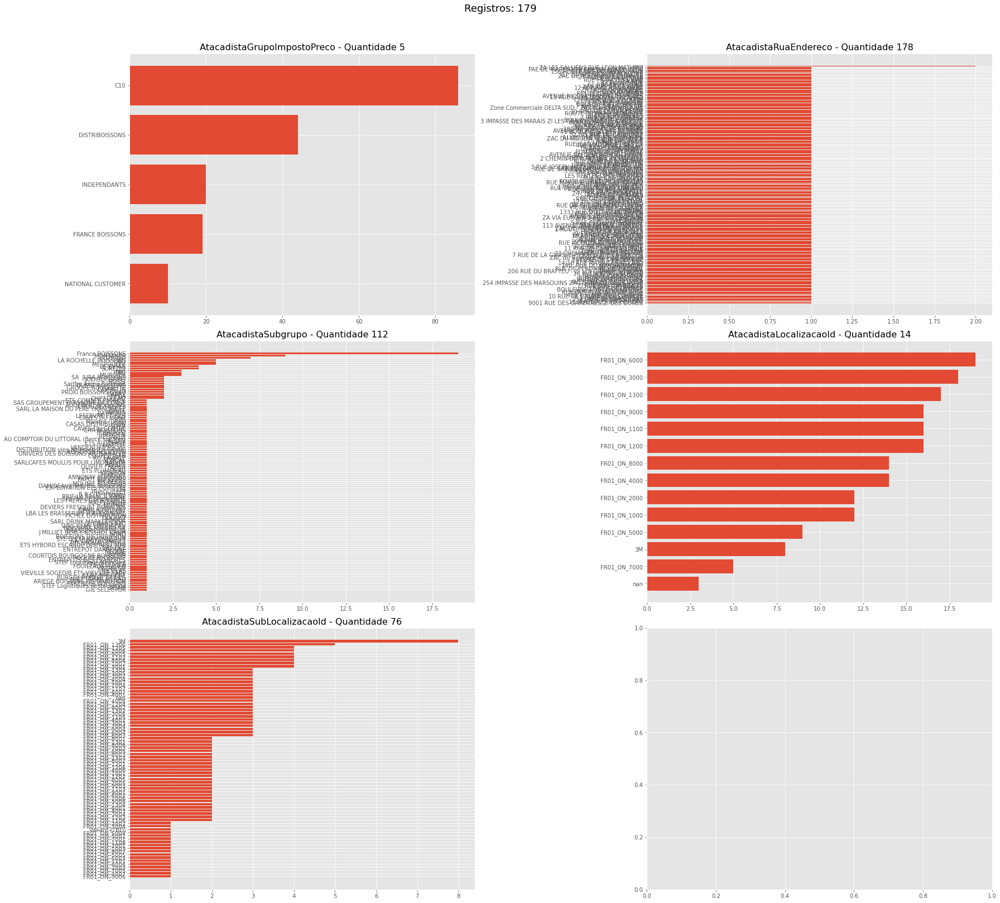

In [53]:
columns = [column for column in df_atacadista.columns if df_atacadista[column].dtype == object]
df_atacadista[columns] = df_atacadista[columns].applymap(str).applymap(str.strip)

n_rows = np.math.ceil(len(columns) / 2)

fig, ax = plt.subplots(nrows=n_rows, ncols=2, figsize=(25,22))
for i, column in enumerate(columns):
    counts = df_atacadista[column].value_counts().sort_values()
    ax.flat[i].barh(counts.index, counts.values)
    ax.flat[i].set_title(f'{column} - Quantidade {len(counts)}', size=16)

plt.suptitle(f'Registros: {len(df_atacadista)}', y=1.02, size=18)
plt.tight_layout()
plt.show()


Visualização das features numéricas

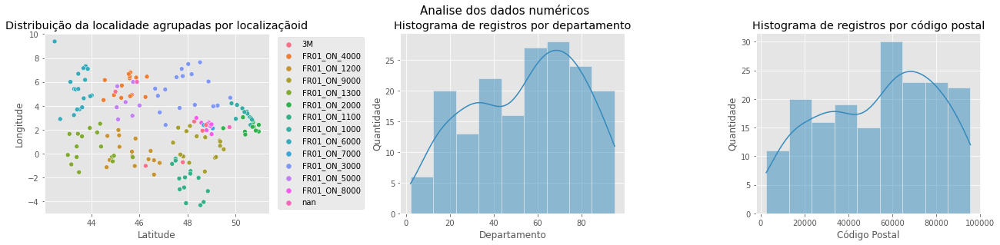

In [54]:
plt.figure(figsize=(18,12))

plt.subplot(331)
plt.title('Distribuição da localidade agrupadas por localizaçãoid')
sns.scatterplot(data=df_atacadista, x='AtacadistaLatitude', y='AtacadistaLongitude', hue='AtacadistaLocalizacaoId')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.legend(bbox_to_anchor=(1.02, 1))

plt.subplot(332)
plt.title('Histograma de registros por departamento')
sns.histplot(data=df_atacadista, x='AtacadistaDepartamento', kde=True)
plt.xlabel('Departamento')
plt.ylabel('Quantidade')

plt.subplot(333)
plt.title('Histograma de registros por código postal')
sns.histplot(data=df_atacadista, x='AtacadistaCodigoPostal', kde=True)
plt.xlabel('Código Postal')
plt.ylabel('Quantidade')

plt.suptitle('Analise dos dados numéricos', fontsize=15)
plt.tight_layout()
plt.show()

#### Criação de feature para agrupar os atacadistas por caracteristicas similares

Remoção da feature AtacadistaEndereco

In [55]:
columns.pop(1)

'AtacadistaRuaEndereco'

In [56]:
from sklearn.preprocessing import LabelEncoder

encoders_atacadista = {}
df_atacadista_encoder = pd.DataFrame(df_atacadista[['PedidoAtacadistaId', 'AtacadistaLatitude', 'AtacadistaLongitude', 'AtacadistaCodigoPostal', 'AtacadistaDepartamento']])

for column in columns:
    encoders_atacadista[column] = LabelEncoder()
    df_atacadista_encoder[column] = encoders_atacadista[column].fit_transform(df_atacadista[column].values.ravel())

df_atacadista_encoder.head()


,PedidoAtacadistaId,AtacadistaLatitude,AtacadistaLongitude,AtacadistaCodigoPostal,AtacadistaDepartamento,AtacadistaGrupoImpostoPreco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId
0,29804035,47.7993,-0.7210,53200,53.0,4,70,0,0
1,29596966,44.5543,6.1627,5000,50.0,1,65,7,42
8,29378967,45.8000,-1.0333,17320,17.0,1,52,3,16
19,29379615,48.0667,-0.7667,53000,53.0,3,74,12,68
31,29563830,44.3601,2.5051,12000,12.0,0,63,4,22


In [57]:
from sklearn.impute import SimpleImputer
imputer_atacadista = {}
df_atacadista_imputer = pd.DataFrame(df_atacadista['PedidoAtacadistaId'])

for column in df_atacadista_encoder.drop(columns=['PedidoAtacadistaId']).columns:
    imputer_atacadista[column] = SimpleImputer(strategy='median')
    df_atacadista_imputer[column] = imputer_atacadista[column].fit_transform(df_atacadista_encoder[column].values.reshape(-1,1))

In [58]:
from sklearn.preprocessing import StandardScaler

scalers_atacadista = {}
df_atacadista_scaler = pd.DataFrame(df_atacadista['PedidoAtacadistaId'])

for column in df_atacadista_imputer.drop(columns=['PedidoAtacadistaId']).columns:
    scalers_atacadista[column] = StandardScaler()
    df_atacadista_scaler[column] = scalers_atacadista[column].fit_transform(df_atacadista_imputer[column].values.reshape(-1,1))

df_atacadista_scaler.head()

,PedidoAtacadistaId,AtacadistaLatitude,AtacadistaLongitude,AtacadistaCodigoPostal,AtacadistaDepartamento,AtacadistaGrupoImpostoPreco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId
0,29804035,0.326712,-1.207175,-0.030542,-0.072857,2.407067,0.454316,-1.671542,-1.568660
1,29596966,-1.091456,1.383582,-1.866349,-0.194740,-0.013523,0.281215,0.225598,0.311931
8,29378967,-0.547045,-1.324713,-1.397113,-1.535450,-0.013523,-0.168845,-0.858482,-0.852244
19,29379615,0.443574,-1.224375,-0.038159,-0.072857,1.600203,0.592796,1.580697,1.476106
31,29563830,-1.176327,0.007003,-1.599738,-1.738588,-0.820386,0.211975,-0.587462,-0.583589


In [59]:
corr = df_atacadista_scaler.drop(columns=['PedidoAtacadistaId']).corr()

<AxesSubplot:>

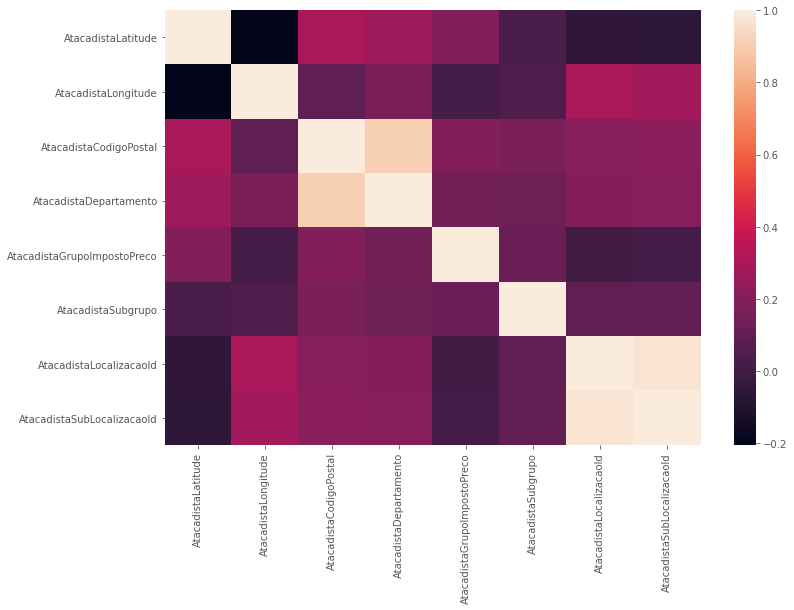

In [60]:
plt.figure(figsize=(12,8))
sns.heatmap(corr)

In [61]:
corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)]

,AtacadistaLatitude,AtacadistaLongitude,AtacadistaCodigoPostal,AtacadistaDepartamento,AtacadistaGrupoImpostoPreco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId
AtacadistaLatitude,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AtacadistaLongitude,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AtacadistaCodigoPostal,NaN,NaN,NaN,0.909202,NaN,NaN,NaN,NaN
AtacadistaDepartamento,NaN,NaN,0.909202,NaN,NaN,NaN,NaN,NaN
AtacadistaGrupoImpostoPreco,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AtacadistaSubgrupo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AtacadistaLocalizacaoId,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.974272
AtacadistaSubLocalizacaoId,NaN,NaN,NaN,NaN,NaN,NaN,0.974272,NaN


In [62]:
corr_columns = []
for column in corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)].unstack().dropna().drop_duplicates().index.map(list):
    corr_columns += (column)

corr_columns.append('PedidoAtacadistaId')
print(corr_columns)

['AtacadistaCodigoPostal', 'AtacadistaDepartamento', 'AtacadistaLocalizacaoId', 'AtacadistaSubLocalizacaoId', 'PedidoAtacadistaId']


In [63]:
corr_columns = ['PedidoAtacadistaId', 'AtacadistaSubLocalizacaoId', 'AtacadistaDepartamento', 'AtacadistaLongitude', 'AtacadistaLatitude']

In [64]:
df_atacadista.drop(columns=['AtacadistaRuaEndereco'] + corr_columns)

,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaSubgrupo,AtacadistaLocalizacaoId
0,NATIONAL CUSTOMER,53200,NEODIF,3M
1,DISTRIBOISSONS,5000,MONTANER,FR01_ON_4000
8,DISTRIBOISSONS,17320,LA ROCHELLE BOISSONS,FR01_ON_1200
19,INDEPENDANTS,53000,OUEST BOISSONS,FR01_ON_9000
31,C10,12000,MESPOULET,FR01_ON_1300
...,...,...,...,...
60890,FRANCE BOISSONS,45770,France BOISSONS,FR01_ON_9000
64078,C10,54700,REGA,FR01_ON_3000
64678,C10,88600,REGA,FR01_ON_3000
71748,INDEPENDANTS,80160,nan,nan


In [65]:
pca_atacadista = PCA(2)
components_atacadista = pca_atacadista.fit_transform(df_atacadista_scaler.drop(columns=corr_columns))
print('Quantidade de correlação explicada por {} componentes principais: {}'.format(pca_atacadista.n_components, sum(pca.explained_variance_ratio_)))

Quantidade de correlação explicada por 2 componentes principais: 0.6187425335328613


### Definição da quantidade de clusters para agrupar os atacadistas com base nas features

In [66]:
wcss = quantidade_cluster(components_atacadista, 21)
n_cluster = quantidade_cluster_otima(wcss)
print('Quantidade cluster: ', n_cluster)

Quantidade cluster:  6


In [67]:
knn_atacadista = KMeans(n_cluster)
labels_atacadista = knn_atacadista.fit_predict(components_atacadista)

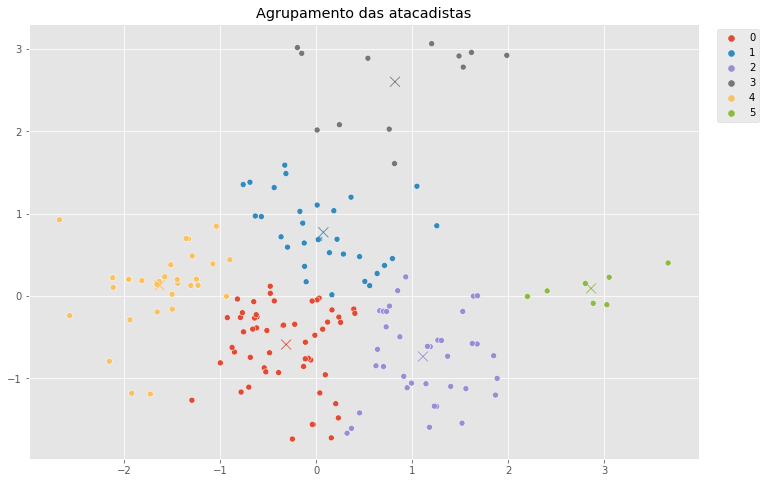

In [86]:
palette = { label: f'C{i}' for i, label in enumerate(range(knn_atacadista.n_clusters))}

plt.figure(figsize=(12,8))
plt.title('Agrupamento das atacadistas')
ax = sns.scatterplot(x=components_atacadista[:,0], y=components_atacadista[:,1], hue=knn_atacadista.labels_, palette=palette)
sns.scatterplot(x=knn_atacadista.cluster_centers_[:,0], y=knn_atacadista.cluster_centers_[:,1], hue=range(knn_atacadista.n_clusters), s=100, palette=palette, legend=False, ax=ax, marker='x')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

In [69]:
df_atacadista['cluster'] = labels_atacadista

In [70]:
df_atacadista.head()

,PedidoAtacadistaId,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,AtacadistaLatitude,AtacadistaLongitude,cluster
0,29804035,NATIONAL CUSTOMER,53200,RUE DE ROMAINVILLE,NEODIF,3M,3M,53.0,47.7993,-0.7210,3
1,29596966,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,44.5543,6.1627,4
8,29378967,DISTRIBOISSONS,17320,RUE JEAN MOULIN,LA ROCHELLE BOISSONS,FR01_ON_1200,FR01_ON_1204,17.0,45.8000,-1.0333,4
19,29379615,INDEPENDANTS,53000,BOULEVARD LEON BOLLEE,OUEST BOISSONS,FR01_ON_9000,FR01_ON_9002,53.0,48.0667,-0.7667,2
31,29563830,C10,12000,RUE DES CHARPENTIERS,MESPOULET,FR01_ON_1300,FR01_ON_1304,12.0,44.3601,2.5051,4


In [71]:
atacadista_id = np.random.choice(df_atacadista['PedidoAtacadistaId'], 1)[0]
cluster = df_atacadista[df_atacadista['PedidoAtacadistaId'] == atacadista_id]['cluster'].values[0]

print(cluster)

df_atacadista[df_atacadista['cluster'] == cluster]

1


,PedidoAtacadistaId,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,AtacadistaLatitude,AtacadistaLongitude,cluster
36,29379836,INDEPENDANTS,73460,LE TRABLEY,LE GRAND ARC,FR01_ON_4000,FR01_ON_4006,73.0,45.5856,6.3045,1
230,29379820,C10,79240,SAE DES ETS MICHENOT,SCOB,FR01_ON_1200,Vacant (TBD),79.0,46.6000,-0.5582,1
232,29379687,FRANCE BOISSONS,33750,Route de Canteloup,France BOISSONS,FR01_ON_1300,FR01_ON_1305,33.0,44.8500,-0.2833,1
382,29727962,INDEPENDANTS,59380,20 RUE ABEL VERMERSCH,BVB,FR01_ON_2000,FR01_ON_2006,59.0,50.9623,2.4096,1
446,29379608,INDEPENDANTS,46310,LE BOURG,DEVIERS FRESQUET BOISSONS,FR01_ON_1200,FR01_ON_1205,46.0,44.6620,1.4835,1
490,29379694,FRANCE BOISSONS,38120,10 AV DE L'ILE BRUNE / ZI,France BOISSONS,FR01_ON_4000,FR01_ON_4006,38.0,45.2627,5.6989,1
694,29379437,DISTRIBOISSONS,56400,KERIQUELLAN EN BRECH,OUEST BOISSONS,FR01_ON_1100,FR01_ON_1103,56.0,47.6703,-2.9918,1
735,29379862,C10,86370,RUE DES HALLES,SA VINS FROMAGET,FR01_ON_1200,FR01_ON_1201,86.0,46.4627,0.2287,1
1008,29799562,DISTRIBOISSONS,60480,ZAC BELLE ASSISE,GROUPE ROUQUETTE,FR01_ON_2000,FR01_ON_2004,60.0,49.4818,2.1280,1
1012,29379651,C10,59132,18 RUE DU FOURNEAU,VIEVILLE SOGEDIB ETS VIEVILLE SARL,FR01_ON_1000,FR01_ON_1001,59.0,50.0566,4.0745,1


In [72]:
print('Silhouette score', silhouette_score(components_atacadista, labels_atacadista))

Silhouette score 0.4107440710795062


## Analise do dataset de pedidos

Analise do sub-dataset de pedido

In [73]:
df_pedido = df_pedido.reset_index(drop=True)

In [74]:
print('Total de pedidos: ', len(df_pedido))

Total de pedidos:  73670


In [75]:
df_pedido.head()

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
0,2019-08-01,63482,1.0,29804035,70.0,4.2,6,1,1,122.037438,14.806188,12.786,12.338490,0.0
1,2019-08-01,6013,4.0,29596966,32.0,6.4,7,1,1,159.181849,62.666534,55.520,52.222112,0.0
2,2019-08-01,10946,3.0,29596966,210.0,12.6,7,1,1,150.689825,17.894369,15.582,14.911974,0.0
3,2019-08-01,65642,20.0,29596966,20.0,4.0,7,1,1,NaN,NaN,NaN,NaN,NaN
4,2019-08-01,11574,40.0,29596966,320.0,96.0,7,1,1,85.212929,57.623832,49.710,48.019860,0.0


### Pedido com apenas fornecedores e pedidos filtrados

Filtrando os pedidos apenas com os fornecedores e produtos filtrados

In [76]:
filtro_produtos = df_pedido['PedidoProdutoId'].isin(df_produto['PedidoProdutoId'])
filtro_atacadistas = df_pedido['PedidoAtacadistaId'].isin(df_atacadista['PedidoAtacadistaId'])
df_pedido_filtro = df_pedido[filtro_produtos & filtro_atacadistas]
df_pedido_filtro.reset_index(drop=True, inplace=True)
df_pedido_filtro

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
0,2019-08-01,10946,3.0,29596966,210.0,12.600,7,1,1,150.689825,17.894369,15.582,14.911974,0.0
1,2019-08-01,20614,1.0,29596966,70.0,4.200,7,1,1,195.587448,22.974970,20.856,19.145808,0.0
2,2019-08-01,30822,10.0,29378967,10.0,0.792,12,1,1,170.754710,25.009891,22.008,20.841576,0.0
3,2019-08-01,59874,30.0,29378967,30.0,2.376,12,1,1,186.904201,28.397491,23.712,23.664576,0.0
4,2019-08-01,20614,2.0,29378967,140.0,8.400,12,1,1,195.587448,22.974970,20.856,19.145808,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27933,2021-02-22,61629,140.0,29379855,140.0,8.400,8,0,1,128.264406,18.093600,15.078,15.078000,0.0
27934,2021-02-22,64665,70.0,29379855,70.0,4.200,8,0,1,208.898843,22.401691,19.902,18.668076,0.0
27935,2021-02-22,48537,70.0,29379855,70.0,4.200,8,0,1,224.599757,22.774752,20.856,18.978960,0.0
27936,2021-02-22,17028,70.0,29379855,70.0,4.200,8,0,1,217.449263,22.774752,20.856,18.978960,0.0


In [77]:
df_pedido_filtro.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27938 entries, 0 to 27937
Data columns (total 14 columns):
 #   Column                                    Non-Null Count  Dtype         
---  ------                                    --------------  -----         
 0   PedidoDataDocumento                       27938 non-null  datetime64[ns]
 1   PedidoProdutoId                           27938 non-null  int64         
 2   PedidoOrdem                               27938 non-null  float64       
 3   PedidoAtacadistaId                        27938 non-null  int64         
 4   PedidoQuantidade                          27936 non-null  float64       
 5   PedidoHectolitroEntregue                  27938 non-null  float64       
 6   PedidoDiasEntrega                         27938 non-null  int64         
 7   PedidoEntregue                            27938 non-null  int64         
 8   PedidoLeadTimeEntrega                     27938 non-null  int64         
 9   PedidoContribuicaoHectolitro

### Entendimento da relação entre os dados de pedido

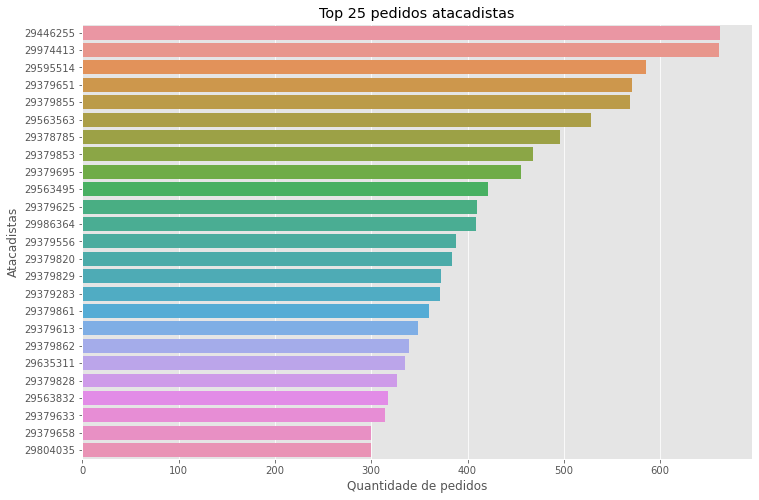

In [78]:
plt.figure(figsize=(12,8))

plt.title('Top 25 pedidos atacadistas')
pedidos_atacadistas = df_pedido_filtro['PedidoAtacadistaId'].value_counts().sort_values(ascending=False)

top_ped_atacadista = pedidos_atacadistas[0:25]
sns.barplot(y=top_ped_atacadista.index, x=top_ped_atacadista.values, orient='h', order=top_ped_atacadista.index)
plt.xlabel('Quantidade de pedidos')
plt.ylabel('Atacadistas')
plt.show()

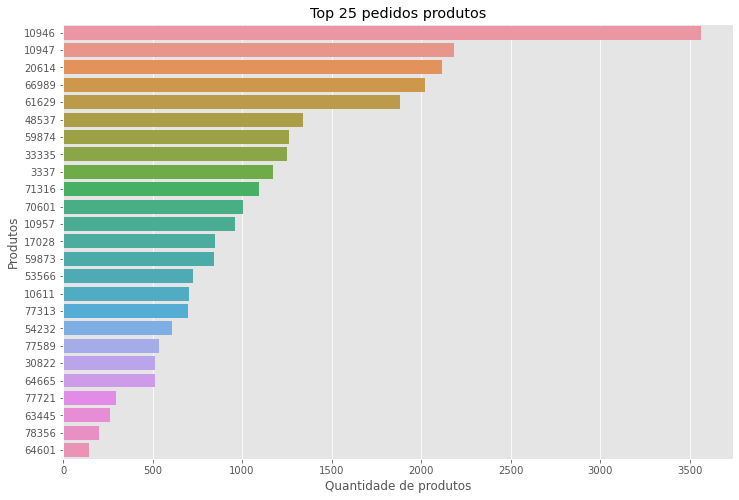

In [79]:
plt.figure(figsize=(12,8))

plt.title('Top 25 pedidos produtos')
pedidos_produtos = df_pedido_filtro['PedidoProdutoId'].value_counts().sort_values(ascending=False)

top_ped_produtos = pedidos_produtos[0:25]
sns.barplot(y=top_ped_produtos.index, x=top_ped_produtos.values, orient='h', order=top_ped_produtos.index)
plt.xlabel('Quantidade de produtos')
plt.ylabel('Produtos')
plt.show()

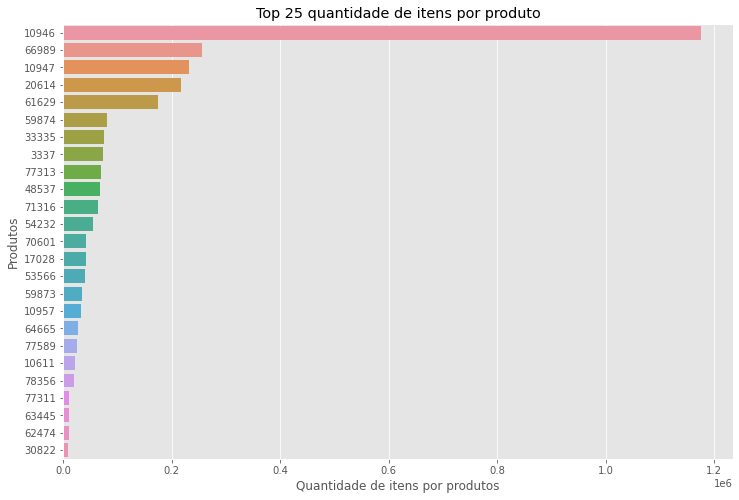

In [80]:
plt.figure(figsize=(12,8))

plt.title('Top 25 quantidade de itens por produto')
qtd_itens_produto = df_pedido_filtro.groupby(['PedidoProdutoId'])['PedidoQuantidade'].sum().sort_values(ascending=False)

top_qtd_itens_prod = qtd_itens_produto[0:25]
sns.barplot(y=top_qtd_itens_prod.index, x=top_qtd_itens_prod.values, orient='h', order=top_qtd_itens_prod.index)
plt.xlabel('Quantidade de itens por produtos')
plt.ylabel('Produtos')
plt.show()

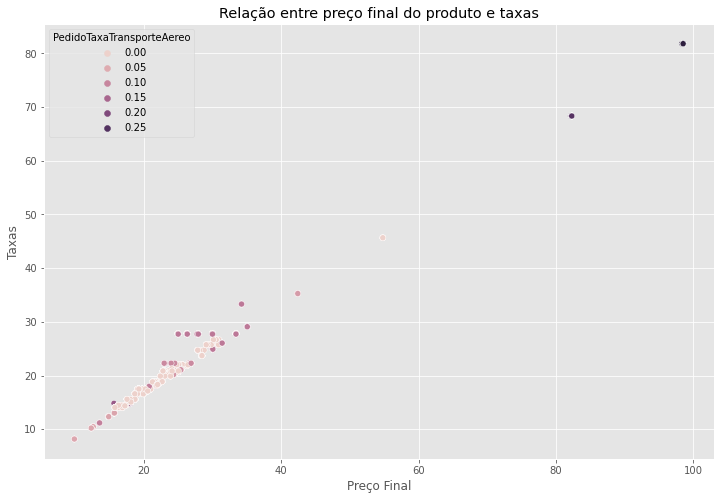

In [81]:
plt.figure(figsize=(12,8))
plt.title('Relação entre preço final do produto e taxas')
sns.scatterplot(data=df_pedido_filtro, x='PedidoPrecoFinalParaUmProd', y='PedidoTaxas', hue='PedidoTaxaTransporteAereo')
plt.xlabel('Preço Final')
plt.ylabel('Taxas')
plt.show()

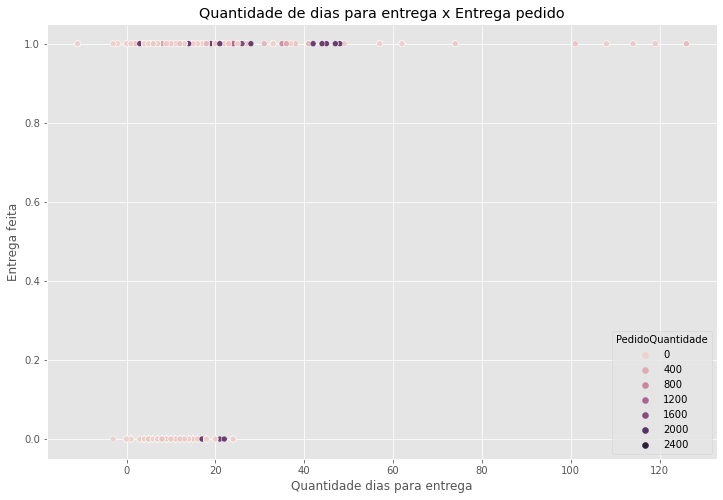

In [82]:
plt.figure(figsize=(12,8))
plt.title('Quantidade de dias para entrega x Entrega pedido')
sns.scatterplot(data=df_pedido_filtro, x='PedidoDiasEntrega', y='PedidoEntregue', hue='PedidoQuantidade')
plt.xlabel('Quantidade dias para entrega')
plt.ylabel('Entrega feita')
plt.show()

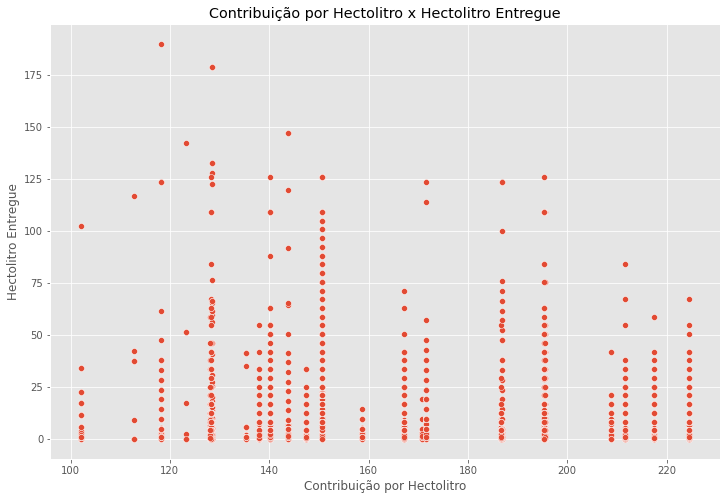

In [83]:
plt.figure(figsize=(12,8))
plt.title('Contribuição por Hectolitro x Hectolitro Entregue')
sns.scatterplot(data=df_pedido_filtro, x='PedidoContribuicaoHectolitro', y='PedidoHectolitroEntregue')
plt.xlabel('Contribuição por Hectolitro')
plt.ylabel('Hectolitro Entregue')
plt.show()

## Considerações da analise

Visando atender a solução proposta para a resolução do desafio que é: **Criar um sistema de recomendação baseado em caracteristicas do produto**, fica claro que a quantidade de features para o dataset de produto extraido do dataset original contém poucas informações sobre as caracteristicas dos produtos.

Para sanar tal problema será necessário enriquecer o dataset com caracteristicas mais ricas que evidencie ainda mais o produto.